In [1]:
import torch
import numpy as np
import math
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import Audio
import librosa

In [2]:
# Constants
sr      = 44100         # Sample rate
gps     = 4             # Grids per sample
c0      = 340           # Speed of sound
h       = 0.002         # Spatial grid size
k       = 1 / gps / sr  # Temporal grid size
lam     = c0 * k / h    # Courant's number
rho0    = 1.1769        # Static air density

lam

0.963718820861678

Text(0, 0.5, 'X-Sectional Area $S(z)$($\\rm m^2$)')

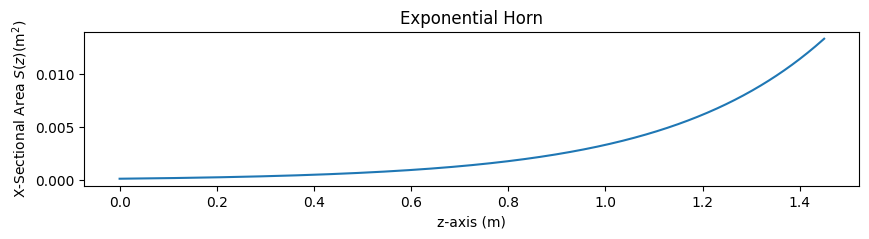

In [3]:
# Bore specs

def cylinder(radius, length):
    return torch.tensor(torch.pi * radius * radius).repeat(int(length / h))

def cone(radius, length):
    return torch.pi * torch.linspace(0., radius, int(length / h) + 1)[1:] ** 2

def exponential(rs, re, length):
    steps = int(length / h)
    x = torch.linspace(0, 1, steps)
    y = rs * (re / rs) ** x
    return torch.pi * y * y

bore_length = 1.45
# bore = cylinder(0.01, bore_length)
# bore = cone(0.04, bore_length)
bore = exponential(0.007, 0.065, bore_length)
bore_m = (bore[:-1] + bore[1:]) / 2  # Midpoints of bore grid
plt.figure(figsize=(10, 2))
plt.title('Exponential Horn')
plt.plot(torch.linspace(0, bore_length, steps=int(bore_length / h)), bore)
plt.xlabel('z-axis (m)')
plt.ylabel('X-Sectional Area $S(z)$($\\rm m^2$)')

Discrete form of Webster horn equation:

$$\begin{align*}
\frac{S_l}{\rho_0c_0^2}\delta_{t+}p_l^n+\delta_{z-}\left(S_{l+1/2}v_{l+1/2}^{n+1/2}\right) & =0\\
\rho_0\delta_{t-}v_{l+1/2}^{n+1/2}+\delta_{z+}p_l^n & =0
\end{align*}$$

Solving for $p_l^{n+1}$ and $v_{l+1/2}^{n+1/2}$ gives:

$$\begin{align*}
p_l^{n+1} & = p_l^n && - \frac{\rho_0c_0^2k}{hS_l}\left(S_{l+1/2}v_{l+1/2}^{n+1/2} - S_{l-1/2}v_{l-1/2}^{n+1/2}\right)\\
v_{l+1/2}^{n+1/2} & = v_{l+1/2}^{n-1/2} && - \frac{k}{\rho_0h}\left(p_{l+1}^{n} - p_l^n\right)
\end{align*}$$

Since the equation is linear we get:

$$\begin{align*}
\bold{p}^{n+1} & =\bold{p}^{n}+D\bold{v}^{n+1/2}\\
\bold{v}^{n+1/2} & =\bold{v}^{n-1/2}+B\bold{p}^n
\end{align*}$$

Apply Dirichlet boundary condition to the back end of the tube:

$$p_N=0$$

Boundary conditions of the front end will be determined by the lip model.

In [4]:
# Create matrices

# bore = torch.tensor([2, 4, 6, 8], dtype=torch.float32)
# bore_m = torch.tensor([3, 5, 7], dtype=torch.float32)

N = bore.shape[0] - 1
assert N == bore_m.shape[0], "size of bore and bore_m must differ by 1"

def make_D():
    main_diag = torch.diag(rho0 * c0 * c0 * k / h / bore[:-1] * bore_m)
    main_diag = torch.cat((main_diag, torch.zeros(1, N)), dim=0)

    subdiag = torch.diag(-rho0 * c0 * c0 * k / h / bore[1:] * bore_m)
    subdiag = torch.cat((torch.zeros(1, N), subdiag), dim=0)

    return main_diag + subdiag

def make_B():
    main_diag = torch.diag(torch.tensor(-k / rho0 / h).repeat(N))
    main_diag = torch.cat((main_diag, torch.zeros(N, 1)), dim=1)

    superdiag = torch.diag(torch.tensor(k / rho0 / h).repeat(N))
    superdiag = torch.cat((torch.zeros(N, 1), superdiag), dim=1)

    return main_diag + superdiag

D = make_D()
B = make_B()

# Boundary conditions

# Dirichlet boundary at back end
B[N-1][N] = 0
D[N][N-1] = 0

D, B

(tensor([[ 386.8188,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
             0.0000],
         [-384.4449,  386.8188,    0.0000,  ...,    0.0000,    0.0000,
             0.0000],
         [   0.0000, -384.4449,  386.8188,  ...,    0.0000,    0.0000,
             0.0000],
         ...,
         [   0.0000,    0.0000,    0.0000,  ..., -384.4449,  386.8189,
             0.0000],
         [   0.0000,    0.0000,    0.0000,  ...,    0.0000, -384.4449,
           386.8188],
         [   0.0000,    0.0000,    0.0000,  ...,    0.0000,    0.0000,
             0.0000]]),
 tensor([[-0.0024,  0.0024,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
         [ 0.0000, -0.0024,  0.0024,  ...,  0.0000,  0.0000,  0.0000],
         [ 0.0000,  0.0000, -0.0024,  ...,  0.0000,  0.0000,  0.0000],
         ...,
         [ 0.0000,  0.0000,  0.0000,  ...,  0.0024,  0.0000,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  ..., -0.0024,  0.0024,  0.0000],
         [ 0.0000,  0.0000,  0.0000,  ...,  0.0000, -0.00

In [5]:
# Lip model

# Raised cosine pulse train
def lip_rc(freq, width, t):
    ph = (t * freq) % 1  # Phase represented by [0, 1)
    # return (ph < width) * (1 - np.cos(2 * math.pi * ph / width)) - width
    return (ph < width) * (1 - np.cos(2 * math.pi * ph / width))

# x = torch.arange(0, 1, step=k)
# y = lip_rc(200, 0.2, x)
# plt.plot(x, y)
# torch.sum(y) * k

/tmp/ipykernel_708/1418071316.py:7: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return (ph < width) * (1 - np.cos(2 * math.pi * ph / width))


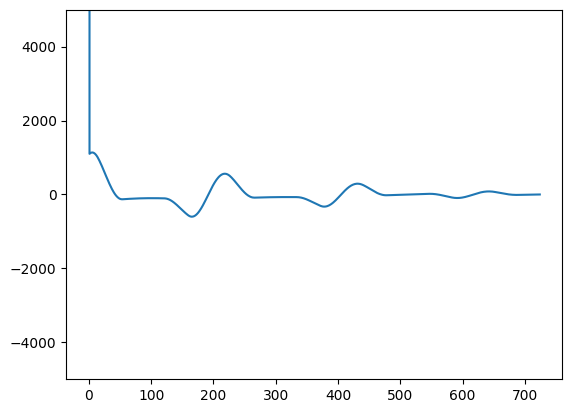

In [6]:
# Animation

p = torch.zeros((N + 1,))
v = torch.zeros((N,))

def step(t):
    global p, v
    v = v + torch.mv(B, p)
    v[0] = lip_rc(800, 0.5, torch.tensor(t))  # Boundary condition by lip model
    p = p + torch.mv(D, v)
    # print(p.abs().max())

# Set up the figure and axis
fig, ax = plt.subplots()
ax.set_ylim((-5000, 5000))
x = torch.arange(0, N+1)
line, = ax.plot(x, p)

# Initialize function: draw the static background
def init():
    line.set_ydata(p)
    return line,

# Animation function: update the y-data
def update(frame):
    step(frame * k)
    line.set_ydata(p)
    return line,

# Create the animation
plt.rcParams['animation.embed_limit'] = 2**30
plt.rcParams["animation.html"] = "jshtml"
ani = FuncAnimation(fig, update, frames=2000, init_func=init, blit=True)

# Show the animation
ani


In [7]:
# Simulation

lip_f = 234

p = torch.zeros((N + 1,))
v = torch.zeros((N,))

result = []

for t in torch.arange(0, 3, step=k):
    if t < 0.5:
        p[0] = lip_rc(lip_f, 0.3, t)
    elif t < 1.:
        p[0] = lip_rc(lip_f * 1.5, 0.3, t)
    elif t < 1.5:
        p[0] = lip_rc(lip_f * 2.0, 0.3, t)
    else:
        p[0] = 0
    v = v + torch.mv(B, p)
    p = p + torch.mv(D, v)

    # Loss
    p *= (1 - 10 * k)

    result.append(p[-10])

/tmp/ipykernel_708/1418071316.py:7: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return (ph < width) * (1 - np.cos(2 * math.pi * ph / width))


/tmp/ipykernel_708/1418071316.py:7: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  return (ph < width) * (1 - np.cos(2 * math.pi * ph / width))


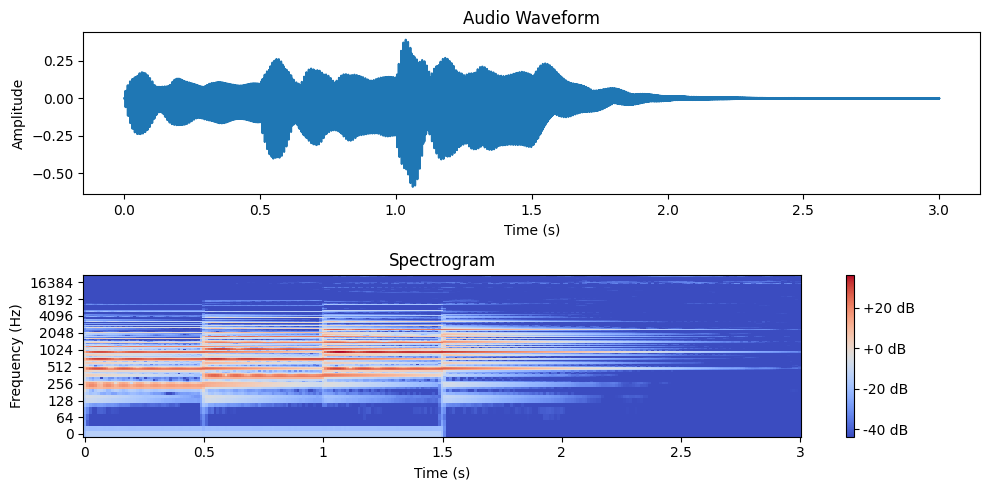

In [8]:
# Audio playback

sound = result[::gps]

# Audio output
display(Audio(sound, rate=sr))
display(Audio(lip_rc(lip_f, 0.2, torch.arange(0, 1, 1/sr)), rate=sr))

# Plot audio waveform
plt.figure(figsize=(10, 5))

plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(sound) / sr, num=len(sound)), sound)
plt.title('Audio Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')

# Compute and plot spectrogram
D_db = librosa.amplitude_to_db(np.abs(librosa.stft(np.array(sound))))

plt.subplot(2, 1, 2)
librosa.display.specshow(D_db, sr=sr, x_axis='time', y_axis='log')
plt.title('Spectrogram')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')

plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()
# librosa.display.specshow(D_db, sr=sr, x_axis='time', y_axis='log')////